# Packages Installation

In [60]:
%pip install matplotlib
%pip install seaborn
%pip install numpy
%pip install pandas-profiling
%pip install scikit-learn
%pip install statsmodels

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
  Using cached scikit_learn-1.1.1-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (31.2 MB)
  Using cached threadpoolctl-3.1.0-py3-none-any.whl (14 kB)
Note: you may need to restart the kernel to use updated packages.


# Packages

In [32]:
import matplotlib 
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport

2022-07-16 14:39:57,337 - visions.backends - INFO - Pandas backend loaded 1.4.2
2022-07-16 14:39:57,347 - visions.backends - INFO - Numpy backend loaded 1.22.4
2022-07-16 14:39:57,349 - visions.backends - INFO - Pyspark backend NOT loaded
2022-07-16 14:39:57,351 - visions.backends - INFO - Python backend loaded


# EDA

## Overview

In [36]:
%reload_kedro

2022-07-16 15:02:08,961 - kedro.extras.extensions.ipython - INFO - No path argument was provided. Using: /home/work/Documents/lighthouse/Desafio/kedro_ds/ds_desafio
2022-07-16 15:02:09,401 - kedro.framework.session.store - INFO - `read()` not implemented for `BaseSessionStore`. Assuming empty store.
2022-07-16 15:02:09,483 - kedro.framework.session.session - WARNING - Unable to git describe /home/work/Documents/lighthouse/Desafio/kedro_ds/ds_desafio
2022-07-16 15:02:09,584 - kedro.extras.extensions.ipython - INFO - ** Kedro project ds_lighthouse
2022-07-16 15:02:09,586 - kedro.extras.extensions.ipython - INFO - Defined global variable `context`, `session`, `catalog` and `pipelines`


In [40]:
election_data = catalog.load("election_data_database")

2022-07-16 15:03:02,193 - kedro.io.data_catalog - INFO - Loading data from `election_data_database` (CSVDataSet)...


In [59]:
election_data.head()

,TimeElapsed,time,territoryName,totalMandates,availableMandates,numParishes,numParishesApproved,blankVotes,blankVotesPercentage,nullVotes,...,pre.votersPercentage,pre.subscribedVoters,pre.totalVoters,Party,Mandates,Percentage,validVotesPercentage,Votes,Hondt,FinalMandates
0,0,2019-10-06 20:10:02,Território Nacional,0,226,3092,1081,9652,2.5,8874,...,52.66,813743,428546,PS,0,38.29,40.22,147993,94,106
1,0,2019-10-06 20:10:02,Território Nacional,0,226,3092,1081,9652,2.5,8874,...,52.66,813743,428546,PPD/PSD,0,33.28,34.95,128624,81,77
2,0,2019-10-06 20:10:02,Território Nacional,0,226,3092,1081,9652,2.5,8874,...,52.66,813743,428546,B.E.,0,6.81,7.15,26307,16,19
3,0,2019-10-06 20:10:02,Território Nacional,0,226,3092,1081,9652,2.5,8874,...,52.66,813743,428546,CDS-PP,0,4.90,5.14,18923,12,5
4,0,2019-10-06 20:10:02,Território Nacional,0,226,3092,1081,9652,2.5,8874,...,52.66,813743,428546,PCP-PEV,0,4.59,4.83,17757,11,12


In [54]:
election_data[election_data["territoryName"]=="Lisboa"].size

30240

In [42]:
election_data_infos = pd.DataFrame({'column': election_data.columns,  
                             'dtype': election_data.dtypes,
                             'missing_percent': election_data.isna().sum()/election_data.shape[0],
                             'count': election_data.count(),
                             'n_unique': election_data.nunique()}).reset_index().drop('index', axis=1).round(decimals = 3),  
print(election_data_infos)

(                      column    dtype  missing_percent  count  n_unique
0                TimeElapsed    int64              0.0  21643        54
1                       time   object              0.0  21643        54
2              territoryName   object              0.0  21643        21
3              totalMandates    int64              0.0  21643        62
4          availableMandates    int64              0.0  21643        69
5                numParishes    int64              0.0  21643        20
6        numParishesApproved    int64              0.0  21643       219
7                 blankVotes    int64              0.0  21643       329
8       blankVotesPercentage  float64              0.0  21643       146
9                  nullVotes    int64              0.0  21643       331
10       nullVotesPercentage  float64              0.0  21643       107
11          votersPercentage  float64              0.0  21643       282
12          subscribedVoters    int64              0.0  21643  

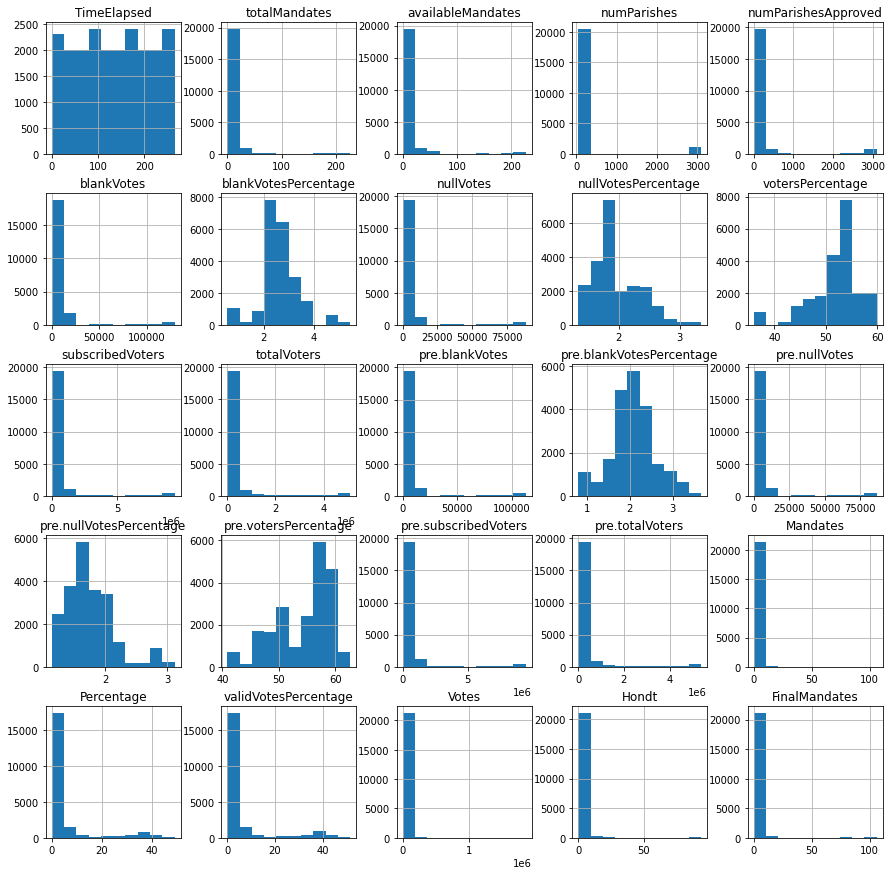

In [43]:
election_data.hist(figsize=(15,15))
plt.show()

In [44]:
profile = ProfileReport(election_data)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]